# Object Detection with LYFT 3D DATASET

Most of the code used here need GPU support since CPU kernels is not enough to handle even the training and some visualizations

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [6]:
!pip install pyquaternion

In [8]:
!pip install tdqm

  Created wheel for tdqm: filename=tdqm-0.0.1-cp36-none-any.whl size=1324 sha256=cc4cce447f632c0277655803b64f7459c1d0b0db0ced3a39ab13876c924cced4
  Stored in directory: /root/.cache/pip/wheels/d5/c0/4b/a98405d8b13071ab9a2be7beeef6820d26349ee46651c16a0d
Successfully built tdqm


In [10]:
!pip install lyft-dataset-sdk

     |████████████████████████████████| 163kB 907kB/s eta 0:00:01
     |████████████████████████████████| 92kB 4.8MB/s eta 0:00:01
     |████████████████████████████████| 102kB 4.8MB/s ta 0:00:01
     |████████████████████████████████| 839kB 4.5MB/s eta 0:00:01
  Created wheel for fire: filename=fire-0.4.0-py2.py3-none-any.whl size=115927 sha256=c8a91a7ea919484148abe692825aec6c9059942c33efa5aeb28bd99f7c65beae
  Stored in directory: /root/.cache/pip/wheels/af/19/30/1ea0cad502dcb4e66ed5a690279628c827aea38bbbab75d5ed
Successfully built fire
ERROR: allennlp 0.8.4 requires awscli>=1.11.91, which is not installed.
ERROR: allennlp 0.8.4 requires flaky, which is not installed.
ERROR: allennlp 0.8.4 requires responses>=0.7, which is not installed.
ERROR: ray 0.7.3 has requirement protobuf>=3.8.0, but you'll have protobuf 3.7.1 which is incompatible.
ERROR: fiona 1.8.6 has requirement click<8,>=4.0, but you'll have click 8.0.4 which is incompatible.
ERROR: cligj 0.5.0 has requirement click<8,>=4

##### Import libraries needed

In [11]:
import os
import gc
import numpy as np
import pandas as pd

import json
import math
import sys
import time
from datetime import datetime
from typing import Tuple, List

import cv2
import matplotlib.pyplot as plt
import sklearn.metrics
from PIL import Image

from matplotlib.axes import Axes
from matplotlib import animation, rc
import plotly.graph_objs as go
import plotly.tools as tls
from plotly.offline import plot, init_notebook_mode
import plotly.figure_factory as ff

init_notebook_mode(connected=True)

import seaborn as sns
from pyquaternion import Quaternion
from tqdm import tqdm

from lyft_dataset_sdk.utils.map_mask import MapMask
from lyft_dataset_sdk.lyftdataset import LyftDataset
from lyft_dataset_sdk.utils.geometry_utils import view_points, box_in_image, BoxVisibility
from lyft_dataset_sdk.utils.geometry_utils import view_points, transform_matrix
from pathlib import Path

import struct
from abc import ABC, abstractmethod
from functools import reduce
from typing import Tuple, List, Dict
import copy
from IPython.display import HTML

In [12]:
!ls ../input/3d-object-detection-for-autonomous-vehicles

sample_submission.csv  test_images  test_maps  train_data    train_lidar
test_data	       test_lidar   train.csv  train_images  train_maps


In [13]:
%matplotlib inline

In [14]:
DATA_PATH = '../input/3d-object-detection-for-autonomous-vehicles/'

In [15]:
from lyft_dataset_sdk.lyftdataset import LyftDataset

In [16]:
# symlink 

# symlink 
DATASET_PATH = '/kaggle/input/3d-object-detection-for-autonomous-vehicles'
DEST_PATH = '/kaggle/working/'

!ln -s $DATASET_PATH/train_images $DEST_PATH/images
!ln -s $DATASET_PATH/train_data $DEST_PATH/data
!ln -s $DATASET_PATH/train_lidar $DEST_PATH/lidar
!ln -s $DATASET_PATH/train_maps $DEST_PATH/maps

In [17]:
# load lyft sdk
from lyft_dataset_sdk.lyftdataset import LyftDataset

# load dataset
level5data = LyftDataset(data_path='./', json_path='./data', verbose=True)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 18.6 seconds.
Reverse indexing ...
Done reverse indexing in 4.6 seconds.


## Exploring The Nature of the dataset

The dataset contains a file, train_data which has JSON file definitions, which are the building blocks of the dataset.

The building blocks are:
    ** Scene: snippet of the car's journey 
    ** Sample: a snapshot of a scene at a particular time
    ** sample_data: data colected from a particular sensor
    ** sample_annotation: an annotation instance of an object 
    ** instance: enumeration of all object instances observed
    ** category: type of the object, for example vehicle or human/person
    ** attribute: property of an instance that can change, but the category remains the same
    ** visibility: visibility of the whole object
    ** sensor: the sensor type that was used
    ** calibrated sensor: definition of a particular sensor as calibrated by a certain vehicle
    ** ego_pose: ego pose estimation at a particular timestamp
    ** log: log information from whch the data was extracted
    ** map: map data stored as semantic masks 

### Scenes loaded in the database

Look at a scene

In [18]:
my_scene = level5data.scene[0]
my_scene

{'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
 'description': '',
 'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
 'nbr_samples': 126,
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'}

### Sample: Annotated keyframe at a given time

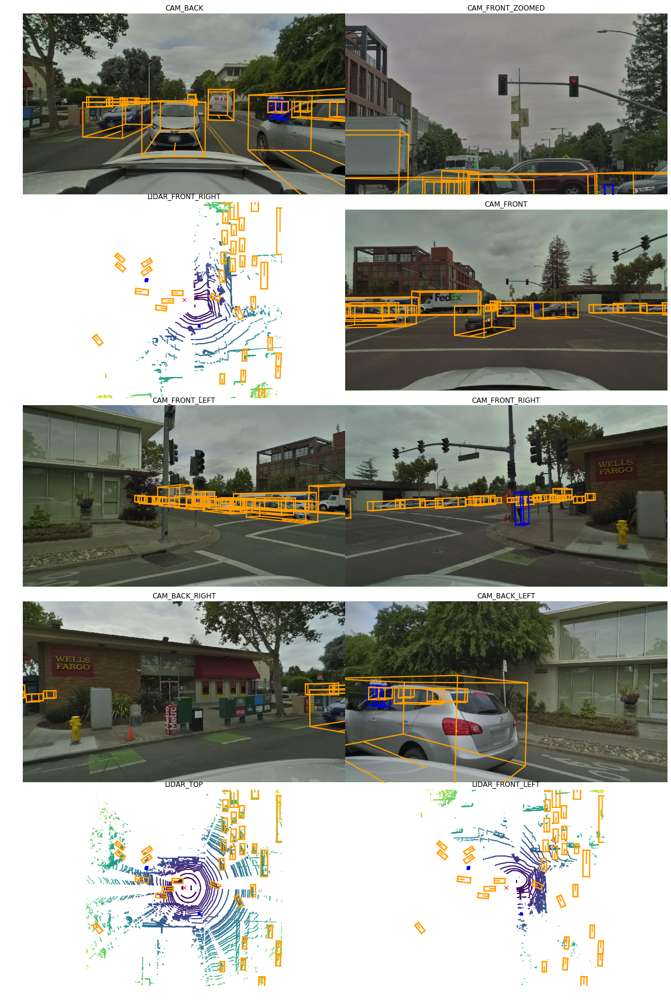

In [19]:
my_sample_token = my_scene["first_sample_token"]

level5data.render_sample(my_sample_token)

In [18]:
my_sample = level5data.get('sample', my_sample_token)
my_sample

{'next': 'c2ba18e4414ce9038ad52efab44e1a0a211ff1e6b297a632805000510756174d',
 'prev': '',
 'token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'timestamp': 1557858039302414.8,
 'scene_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'data': {'CAM_BACK': '542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4',
  'CAM_FRONT_ZOOMED': '9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e',
  'LIDAR_FRONT_RIGHT': '8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff',
  'CAM_FRONT': 'fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0',
  'CAM_FRONT_LEFT': 'f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c',
  'CAM_FRONT_RIGHT': '5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40',
  'CAM_BACK_RIGHT': 'ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d',
  'CAM_BACK_LEFT': '01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23c8b4b',
  'LIDAR

A list of the related sample_data keyframes and sample_annotation associated with a sample can also be looked into using the list_sample method

In [19]:
level5data.list_sample(my_sample['token'])

Sample: 24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8

sample_data_token: 542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4, mod: camera, channel: CAM_BACK
sample_data_token: 9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e, mod: camera, channel: CAM_FRONT_ZOOMED
sample_data_token: 8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff, mod: lidar, channel: LIDAR_FRONT_RIGHT
sample_data_token: fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0, mod: camera, channel: CAM_FRONT
sample_data_token: f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c, mod: camera, channel: CAM_FRONT_LEFT
sample_data_token: 5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40, mod: camera, channel: CAM_FRONT_RIGHT
sample_data_token: ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d, mod: camera, channel: CAM_BACK_RIGHT
sample_data_token: 01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23

###### Rendering Images and Point Clouds

LIDAR point cloud data can sl obe rendered into 2D camera images

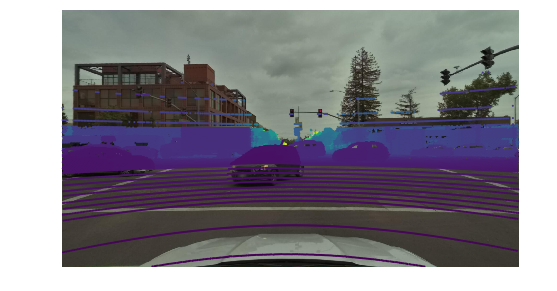

In [20]:
level5data.render_pointcloud_in_image(sample_token = my_sample["token"],dot_size = 1,camera_channel = 'CAM_FRONT')

The data attribute/key can be used to access reference to the dataset

In [21]:
my_sample['data']

{'CAM_BACK': '542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4',
 'CAM_FRONT_ZOOMED': '9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e',
 'LIDAR_FRONT_RIGHT': '8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff',
 'CAM_FRONT': 'fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0',
 'CAM_FRONT_LEFT': 'f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c',
 'CAM_FRONT_RIGHT': '5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40',
 'CAM_BACK_RIGHT': 'ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d',
 'CAM_BACK_LEFT': '01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23c8b4b',
 'LIDAR_TOP': 'ec9950f7b5d4ae85ae48d07786e09cebbf4ee771d054353f1e24a95700b4c4af',
 'LIDAR_FRONT_LEFT': '5c3d79e1cf8c8182b2ceefa33af96cbebfc71f92e18bf64eb8d4e0bf162e01d4'}

Data at a particular sensor can also be rendered

In [22]:
sensor_channel = 'CAM_FRONT'
my_sample_data = level5data.get('sample_data', my_sample['data'][sensor_channel])

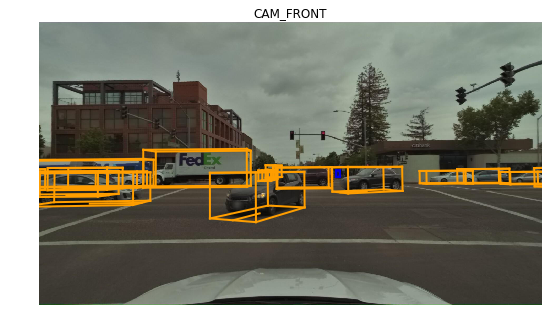

In [23]:
level5data.render_sample_data(my_sample_data['token'])

#### Sample annotations

Any bounding box indicating the location of an item seen in a sample is referred to as a sample annotation. The global coordinate system is used to reference all position information.

From the sample above, the annotations can be examined:

In [24]:
my_annotation_token = my_sample['anns'][16]
my_annotation =  my_sample_data.get('sample_annotation', my_annotation_token)
my_annotation

'1ec543ca38666e906886b71f662f45f1605344410e26962a58668a7511ba65ce'

An annotation can also be rendered:

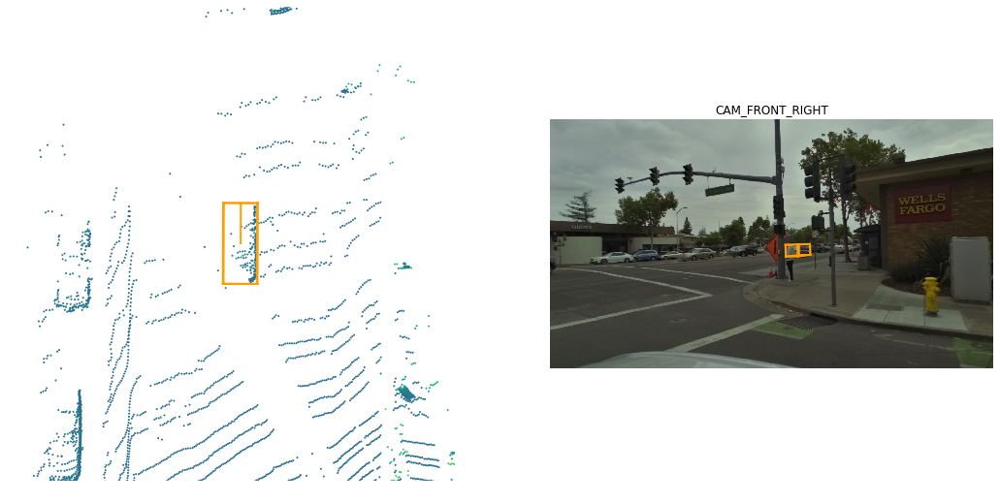

In [25]:
level5data.render_annotation(my_annotation_token)

#### Instance

These are objects that need to be tracked or detected

In [26]:
my_instance = level5data.instance[100]
my_instance

{'last_annotation_token': '17be5c0175d3f4e36b9829d4789a6174d531637587107a0bfa1f3668d1ed9a57',
 'category_token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'token': '0984d7f7d64a8a03523e43ea01c7292488bd73ae745514077b28a9dc240b9f95',
 'first_annotation_token': 'b1f924cb04786ef4d46810ef8c3e7fe17597d4464507267dc56dcfbe1faa6581',
 'nbr_annotations': 56}

An instance can be tracked across different frames in a certain scene but not in different scenes

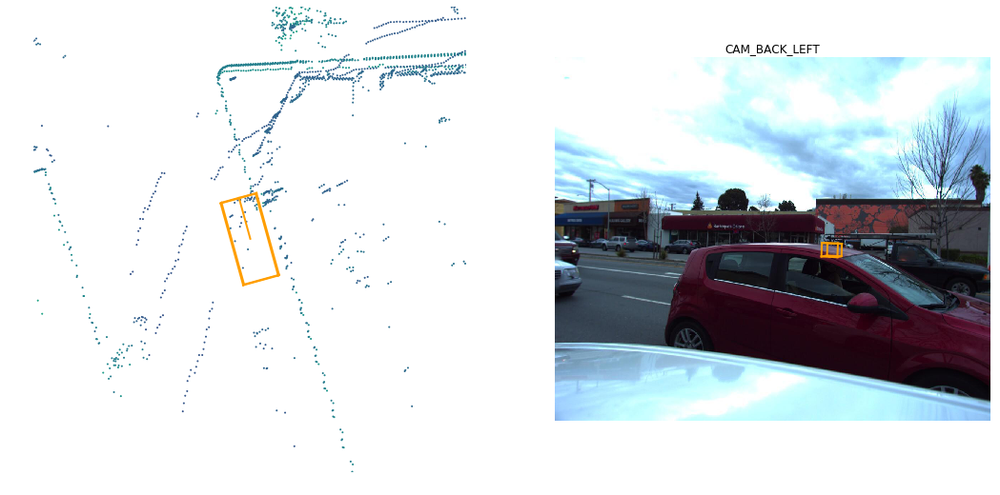

In [27]:
instance_token = my_instance['token']
level5data.render_instance(instance_token)

### Category: Is the object assignment of an annotation

In [28]:
level5data.list_categories()

Category stats
animal                      n=  186, width= 0.36±0.12, len= 0.73±0.19, height= 0.51±0.16, lw_aspect= 2.16±0.56
bicycle                     n=20928, width= 0.63±0.24, len= 1.76±0.29, height= 1.44±0.37, lw_aspect= 3.20±1.17
bus                         n= 8729, width= 2.96±0.24, len=12.34±3.41, height= 3.44±0.31, lw_aspect= 4.17±1.10
car                         n=534911, width= 1.93±0.16, len= 4.76±0.53, height= 1.72±0.24, lw_aspect= 2.47±0.22
emergency_vehicle           n=  132, width= 2.45±0.43, len= 6.52±1.44, height= 2.39±0.59, lw_aspect= 2.66±0.28
motorcycle                  n=  818, width= 0.96±0.20, len= 2.35±0.22, height= 1.59±0.16, lw_aspect= 2.53±0.50
other_vehicle               n=33376, width= 2.79±0.30, len= 8.20±1.71, height= 3.23±0.50, lw_aspect= 2.93±0.53
pedestrian                  n=24935, width= 0.77±0.14, len= 0.81±0.17, height= 1.78±0.16, lw_aspect= 1.06±0.20
truck                       n=14164, width= 2.84±0.32, len=10.24±4.09, height= 3.44±0.62, lw_asp

For example a particular category can be:

In [29]:
level5data.category[2]

{'description': '',
 'token': 'f81f51e1897311b55c0c6247c3db825466733e08df687c0ea830b026316a1c12',
 'name': 'animal'}

### Attribute

Attribure can change throughout the scene but the category will remain the same

In [30]:
level5data.list_attributes()

is_stationary: 321981
object_action_abnormal_or_traffic_violation: 2
object_action_driving_straight_forward: 244805
object_action_gliding_on_wheels: 165
object_action_lane_change_left: 1463
object_action_lane_change_right: 1370
object_action_left_turn: 5074
object_action_loss_of_control: 1
object_action_other_motion: 582
object_action_parked: 257939
object_action_reversing: 278
object_action_right_turn: 6694
object_action_running: 621
object_action_sitting: 586
object_action_standing: 5332
object_action_stopped: 94970
object_action_u_turn: 407
object_action_walking: 17890


### Sensor Type

The sensor type used to collect data are LIDAR and camera

In [31]:
level5data.sensor

[{'modality': 'camera',
  'channel': 'CAM_FRONT_LEFT',
  'token': 'f7dad6bb70cb8e6245f96e5537e382848335872e6e259218b0a80cc071d162c4'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_LEFT',
  'token': '629da739ea3a0814b9d79ffc3b99cdbc8bdbb6f97abf139f1ad33bd12f8fa94d'},
 {'modality': 'camera',
  'channel': 'CAM_FRONT',
  'token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60'},
 {'modality': 'lidar',
  'channel': 'LIDAR_TOP',
  'token': '25bf751d7e35f295393d8a418731474b21c1f702e878c4553f112397caa48c08'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_LEFT',
  'token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_RIGHT',
  'token': '953faed96fd3d2fae3ec03cd2838b312b8c1a9bb7a0629481982870cb28acb67'},
 {'modality': 'camera',
  'channel': 'CAM_BACK',
  'token': '172a55e2b50f18a6b6d545369a457003c2f3b438d0180b2b4c7819ca29b3f6ab'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_RIGHT',
  'token': '8e0

In [32]:
level5data.sample_data[10]

{'is_key_frame': True,
 'fileformat': 'bin',
 'prev': '89e066a61d09acfb201c91d9f2b9bef2d89d96a22ab41efb09704a1319567872',
 'calibrated_sensor_token': '7efae113b75a3c387bb2a92439be7e795e5caabd5819b4e9b6f89e8955c87a44',
 'token': '5146c66963a2100cc5850485741dbf30aae6fc500a684be1ff677d45d2a5b616',
 'timestamp': 1551388503101689.8,
 'next': '3f2ef26d47f69a1f0ad69393d065fd8d29fcdcb5a0cf0340b3522102d48862ce',
 'ego_pose_token': 'c51a6d17e3c5c17d0a4a8a0208785143b060d954dd78bb93ec4653b4897fc87d',
 'sample_token': '2bd45a80fba943914188bc31fa3bc8a5b9b4156da4376cede52d76347b1ac7ef',
 'filename': 'lidar/host-a015_lidar1_1235423703101689806.bin',
 'sensor_modality': 'lidar',
 'channel': 'LIDAR_TOP'}

### Calibrated Sensor

Consists of the definition of a particular sensor as calibrated on a particular vehicle

In [33]:
level5data.calibrated_sensor[0]

{'sensor_token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1',
 'rotation': [-0.6784803059109364,
  0.6875255645268346,
  0.1910946403595628,
  -0.1745162199880262],
 'camera_intrinsic': [[882.42699274, 0, 602.047851885],
  [0.0, 882.42699274, 527.99972239],
  [0.0, 0.0, 1.0]],
 'translation': [1.0399186259366102, 0.30857658859026604, 1.65459751959659],
 'token': '80349b63ead8bfe5f4ce2cbe27fed9e4b5d699a5fc422232349263d21cd5eb70'}

### Ego Pose

Contains the information about the location and the orientation of the vehicle body frame,
with respect to the global coordinate system

In [34]:
level5data.ego_pose[0]

{'rotation': [0.8045437502844562,
  0.02410792365998265,
  0.016871015279640935,
  0.5931639998672046],
 'translation': [622.726103039258, 3460.3733051620957, -6.813459358283256],
 'token': '2de7c52546f3f9bf6734084da8a2c1edaa0ffbea7f6e86f76a6ea66593d9a26b',
 'timestamp': 1547165667901671.8}

### Log

Contains information from which the data was extracted, for example we can check the number of logs and the metadata of a log.

In [35]:
print("Number of `logs` in our loaded database: {}".format(len(level5data.log)))

Number of `logs` in our loaded database: 180


In [36]:
level5data.log[0]

{'date_captured': '2019-05-14',
 'location': 'Palo Alto',
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'vehicle': 'a101',
 'logfile': '',
 'map_token': '53992ee3023e5494b90c316c183be829'}

### Map

Map contains spatial information in a 2D image

In [37]:
print("There are {} maps masks in the loaded dataset".format(len(level5data.map)))

There are 1 maps masks in the loaded dataset


### Visibility

Visibility of the dataset

In [38]:
level5data.visibility

[{'level': 'v60-80',
  'description': 'visibility of whole object is between 60 and 80%',
  'token': '3'},
 {'level': 'v0-40',
  'description': 'visibility of whole object is between 0 and 40%',
  'token': '1'},
 {'level': 'v40-60',
  'description': 'visibility of whole object is between 40 and 60%',
  'token': '2'},
 {'level': 'v80-100',
  'description': 'visibility of whole object is between 80 and 100%',
  'token': '4'}]

# Rendering

2D data can be plotted alongside LIDAR which will accurately map the surroundings in 3D

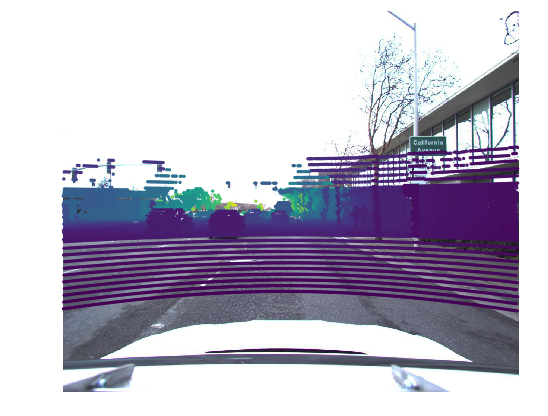

In [39]:
my_sample = level5data.sample[10]
level5data.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='LIDAR_TOP')

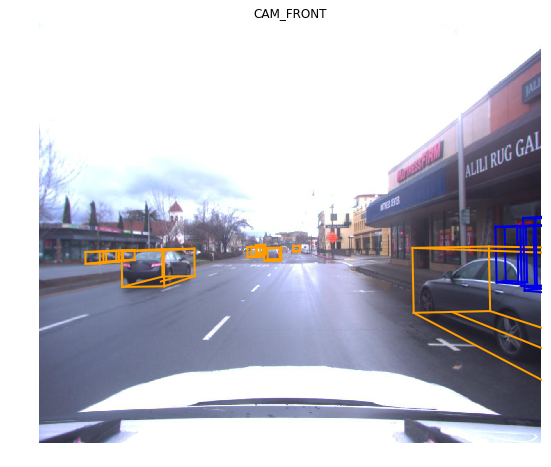

In [40]:
my_sample = level5data.sample[20]
level5data.render_sample_data(my_sample['data']['CAM_FRONT'])

Additionally point clouds can be aggregated from multiple sweeps to get a denser point cloud

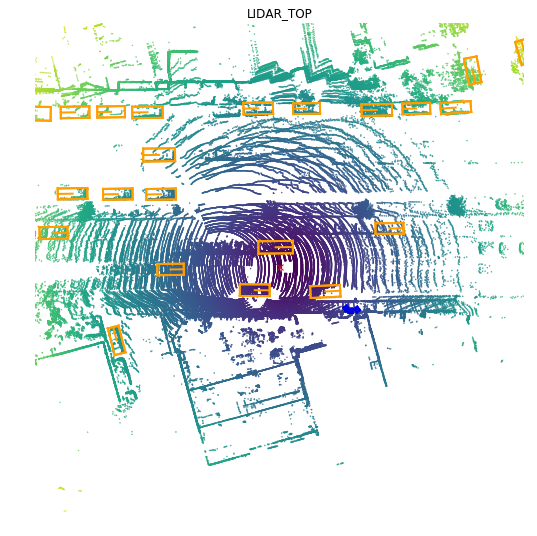

In [41]:
level5data.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=5)

A specific notation can also be visualized

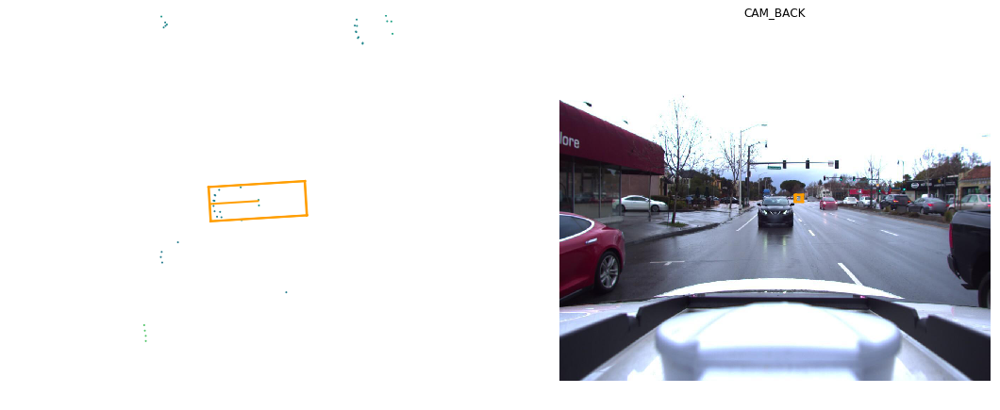

In [42]:
level5data.render_annotation(my_sample['anns'][22])

#### Exploring the training dataframe

In [47]:
train = pd.read_csv(DATA_PATH + 'train.csv')
sample_submission = pd.read_csv(DATA_PATH + 'sample_submission.csv')

In [48]:
object_columns = ['sample_id', 'object_id', 'center_x', 'center_y', 'center_z',
                  'width', 'length', 'height', 'yaw', 'class_name']
objects = []
for sample_id, ps in tqdm(train.values[:]):
    object_params = ps.split()
    n_objects = len(object_params)
    for i in range(n_objects // 8):
        x, y, z, w, l, h, yaw, c = tuple(object_params[i * 8: (i + 1) * 8])
        objects.append([sample_id, i, x, y, z, w, l, h, yaw, c])
train_objects = pd.DataFrame(
    objects,
    columns = object_columns
)

100%|██████████| 22680/22680 [00:02<00:00, 10814.77it/s]


In [49]:
numerical_cols = ['object_id', 'center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']
train_objects[numerical_cols] = np.float32(train_objects[numerical_cols].values)

#### Center X and Center Y

center_x and center_y correspond to the x amd y coordinates of the
center of an object's location, and represent the coordinates of an object in the x-y plane

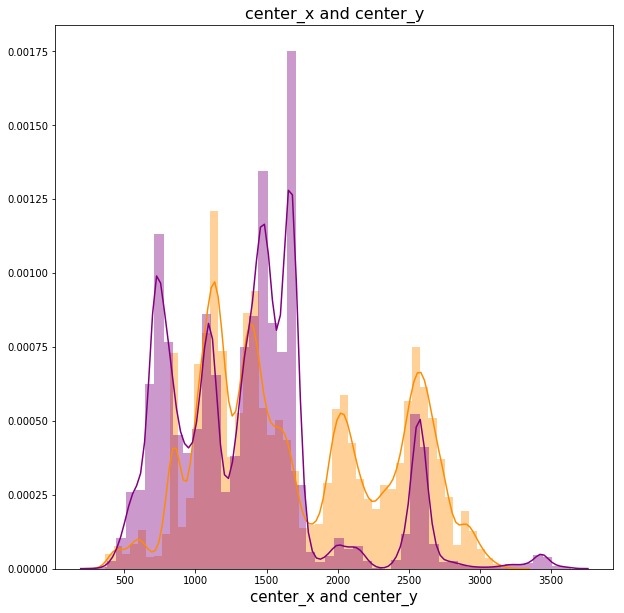

In [50]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.distplot(train_objects['center_x'], color='darkorange', ax=ax).set_title('center_x and center_y', fontsize=16)
sns.distplot(train_objects['center_y'], color='purple', ax=ax).set_title('center_x and center_y', fontsize=16)
plt.xlabel('center_x and center_y', fontsize=15)
plt.show()

#### Kernel Density Estimator PLOT

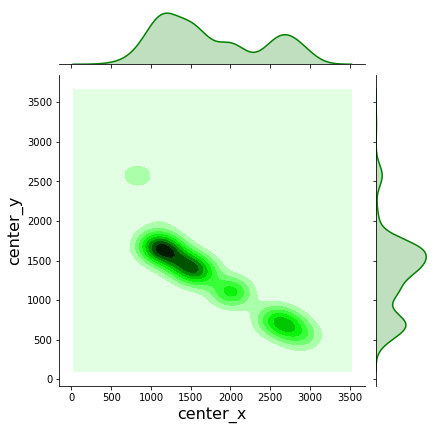

In [52]:
new_train_objects = train_objects.query('class_name == "car"')
plot = sns.jointplot(x=new_train_objects['center_x'][:1000], y=new_train_objects['center_y'][:1000], kind='kde', color='green')
plot.set_axis_labels('center_x', 'center_y', fontsize=16)
plt.show()

#### Center Z

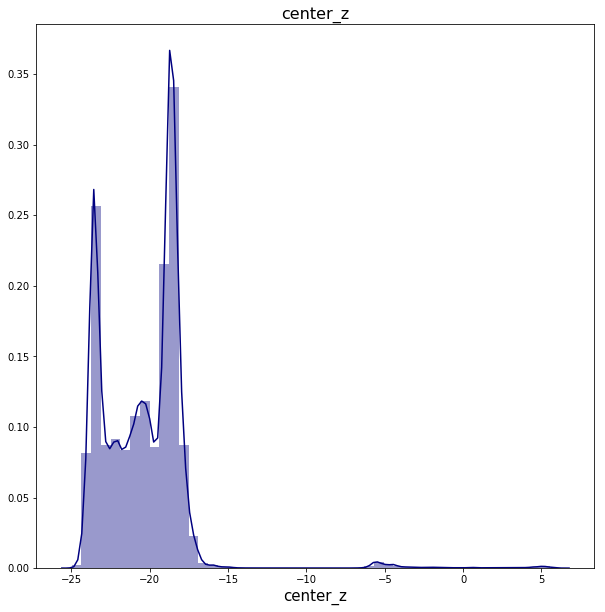

In [54]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.distplot(train_objects['center_z'], color='navy', ax=ax).set_title('center_z', fontsize=16)
plt.xlabel('center_z', fontsize=15)
plt.show()

#### Width of Objects

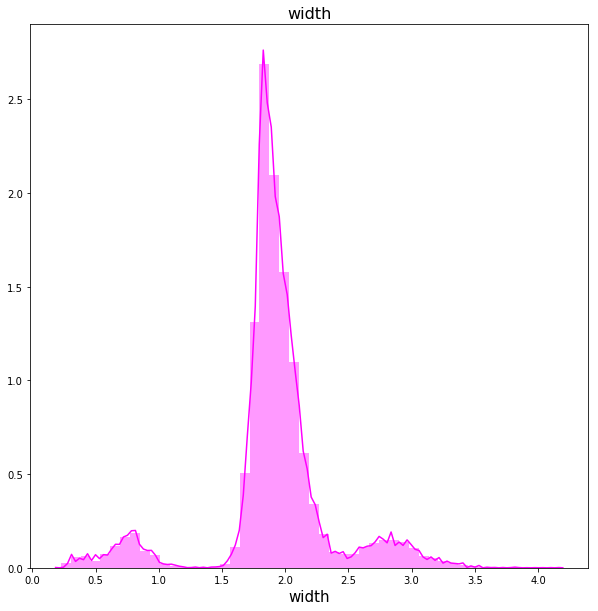

In [55]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.distplot(train_objects['width'], color='magenta', ax=ax).set_title('width', fontsize=16)
plt.xlabel('width', fontsize=15)
plt.show()

#### Length

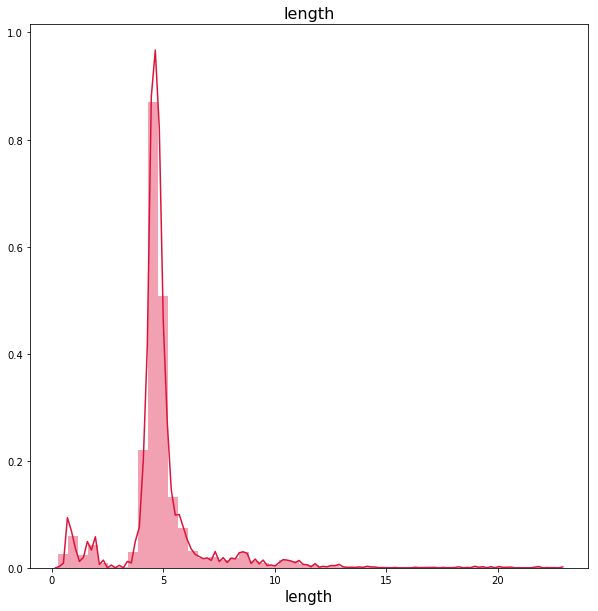

In [57]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.distplot(train_objects['length'], color='crimson', ax=ax).set_title('length', fontsize=16)
plt.xlabel('length', fontsize=15)
plt.show()

#### Height

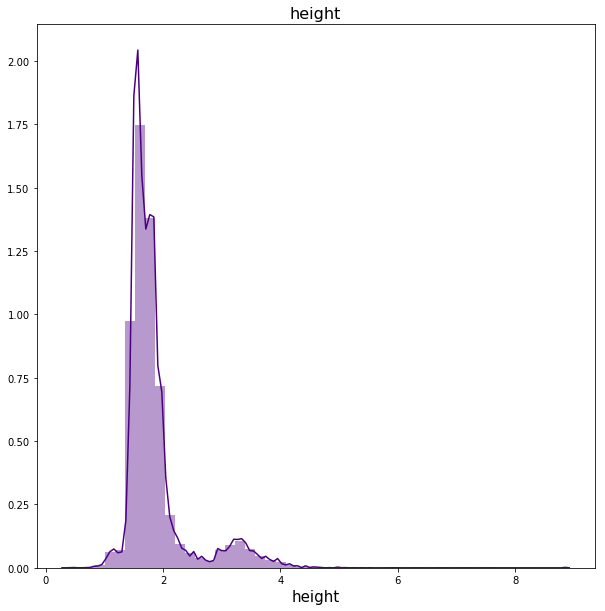

In [56]:

fig, ax = plt.subplots(figsize=(10, 10))
sns.distplot(train_objects['height'], color='indigo', ax=ax).set_title('height', fontsize=16)
plt.xlabel('height', fontsize=15)
plt.show()

#### Frequency of categories of objects

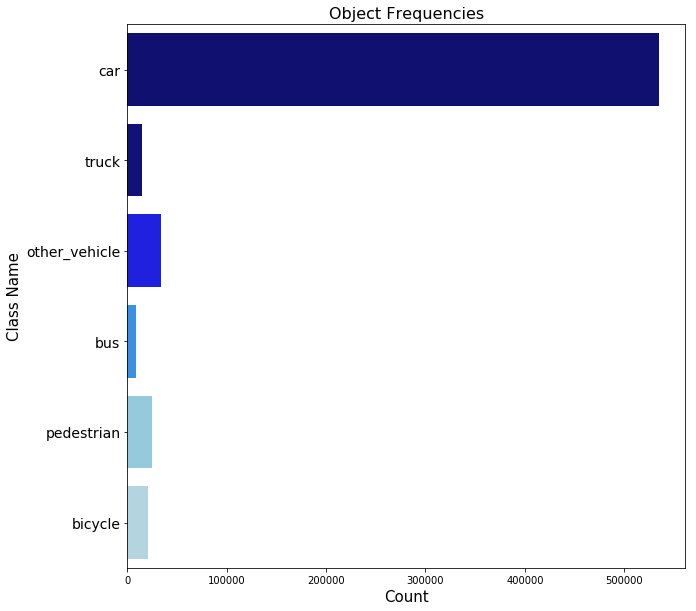

In [58]:
fig, ax = plt.subplots(figsize=(10, 10))
plot = sns.countplot(y="class_name", data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"'),
                     palette=['navy', 'darkblue', 'blue', 'dodgerblue', 'skyblue', 'lightblue']).set_title('Object Frequencies', fontsize=16)
plt.yticks(fontsize=14)
plt.xlabel("Count", fontsize=15)
plt.ylabel("Class Name", fontsize=15)
plt.show(plot)

### Violin Plots and Box Plots

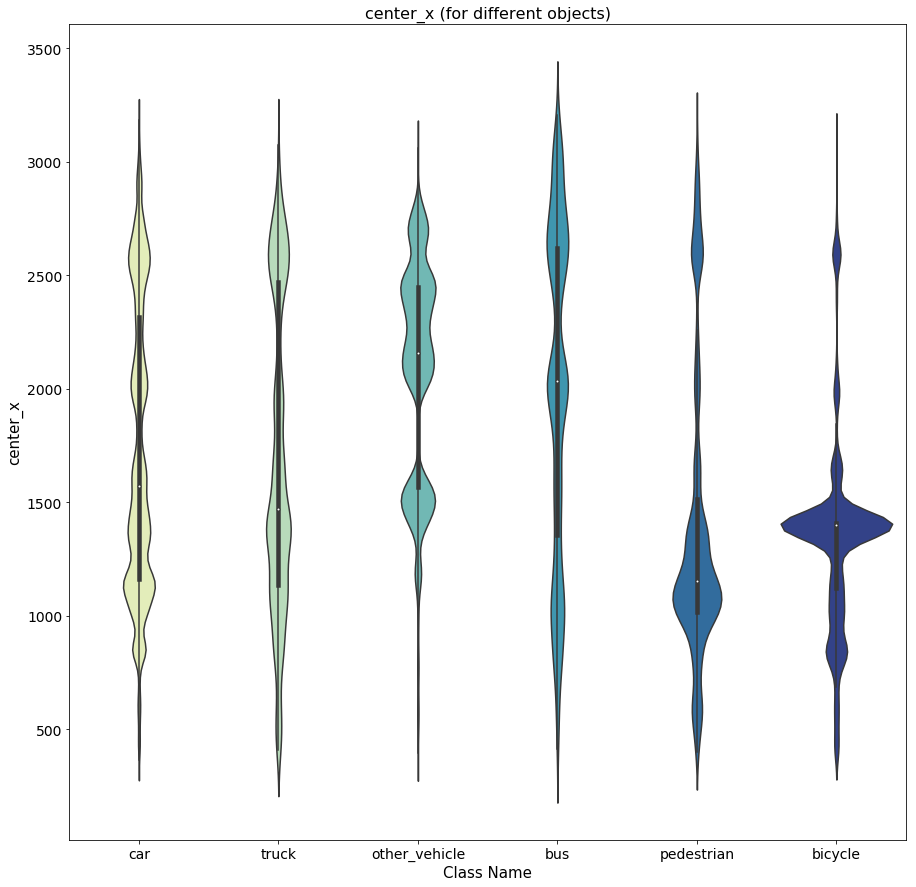

In [59]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.violinplot(x="class_name", y="center_x",
                      data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"'),
                      palette='YlGnBu',
                      split=True, ax=ax).set_title('center_x (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("center_x", fontsize=15)
plt.show(plot)

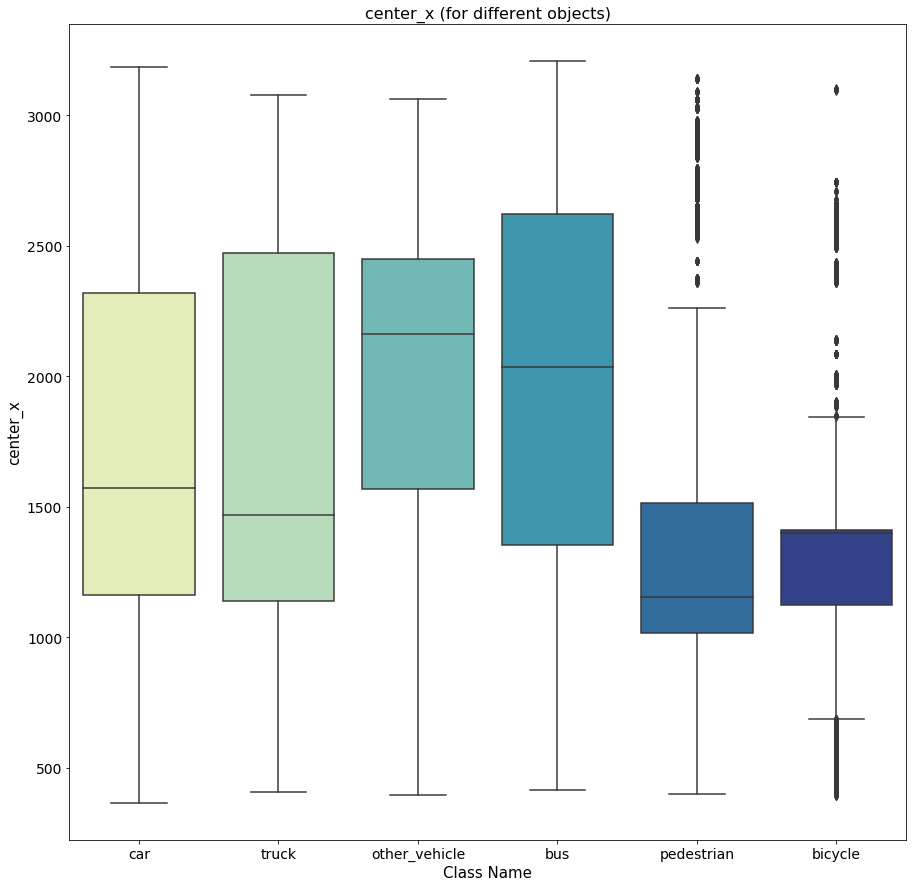

In [60]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.boxplot(x="class_name", y="center_x",
                   data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"'),
                   palette='YlGnBu', ax=ax).set_title('center_x (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("center_x", fontsize=15)
plt.show(plot)

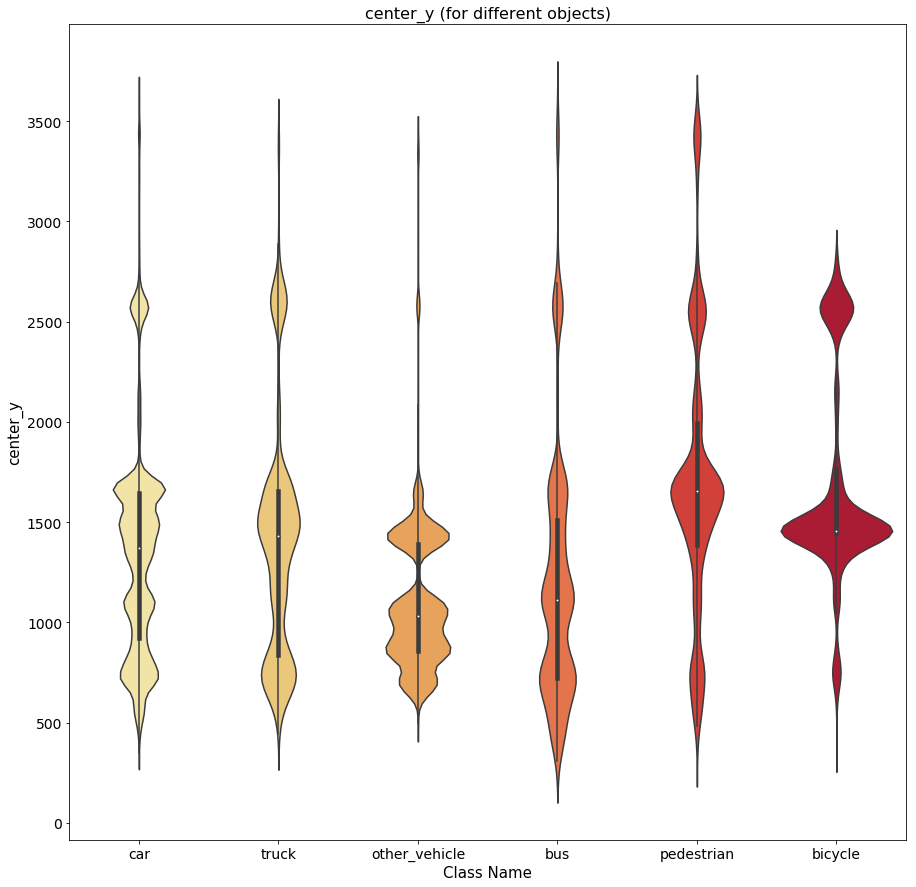

In [61]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.violinplot(x="class_name", y="center_y",
                      data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"'),
                      palette='YlOrRd',
                      split=True, ax=ax).set_title('center_y (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("center_y", fontsize=15)
plt.show(plot)

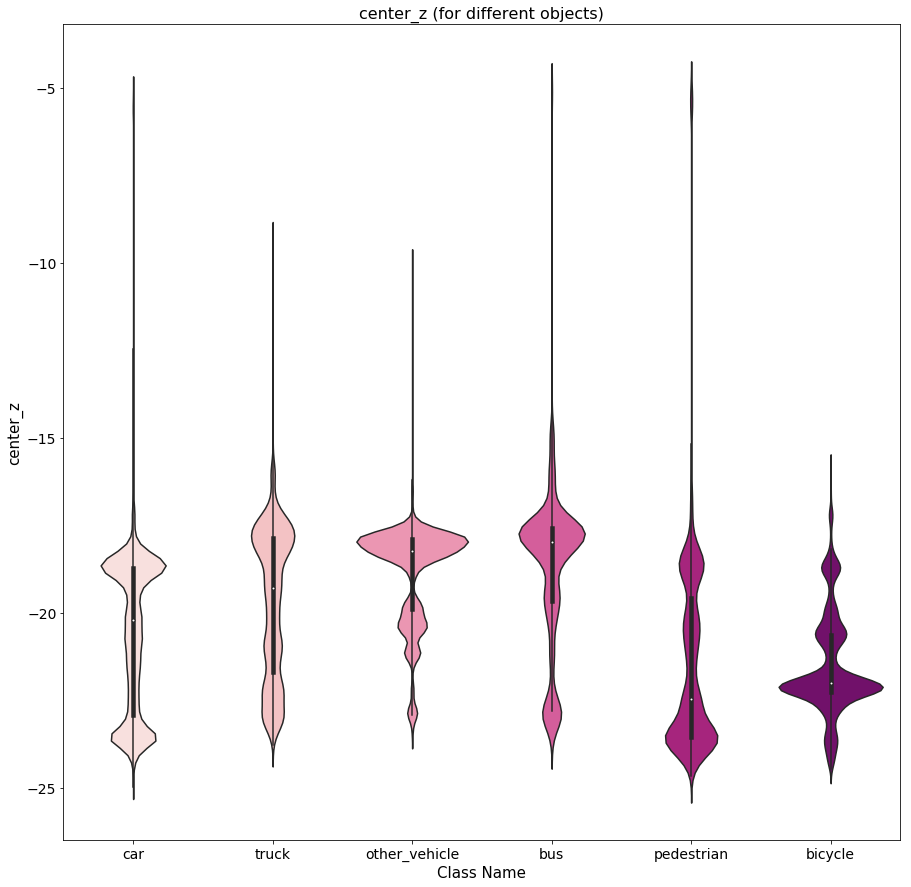

In [62]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.violinplot(x="class_name", y="center_z",
                      data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"').query('center_z <= -5'),
                      palette='RdPu',
                      split=True, ax=ax).set_title('center_z (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("center_z", fontsize=15)
plt.show(plot)

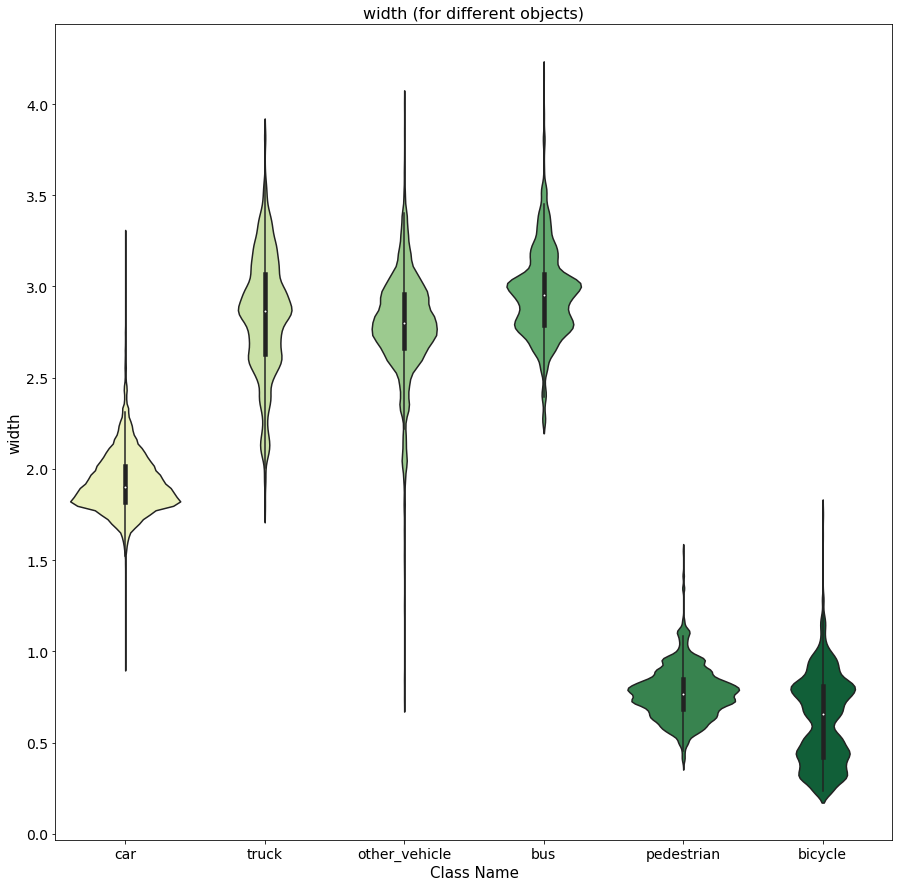

In [63]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.violinplot(x="class_name", y="width",
                      data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal"'),
                      palette='YlGn',
                      split=True, ax=ax).set_title('width (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("width", fontsize=15)
plt.show(plot)

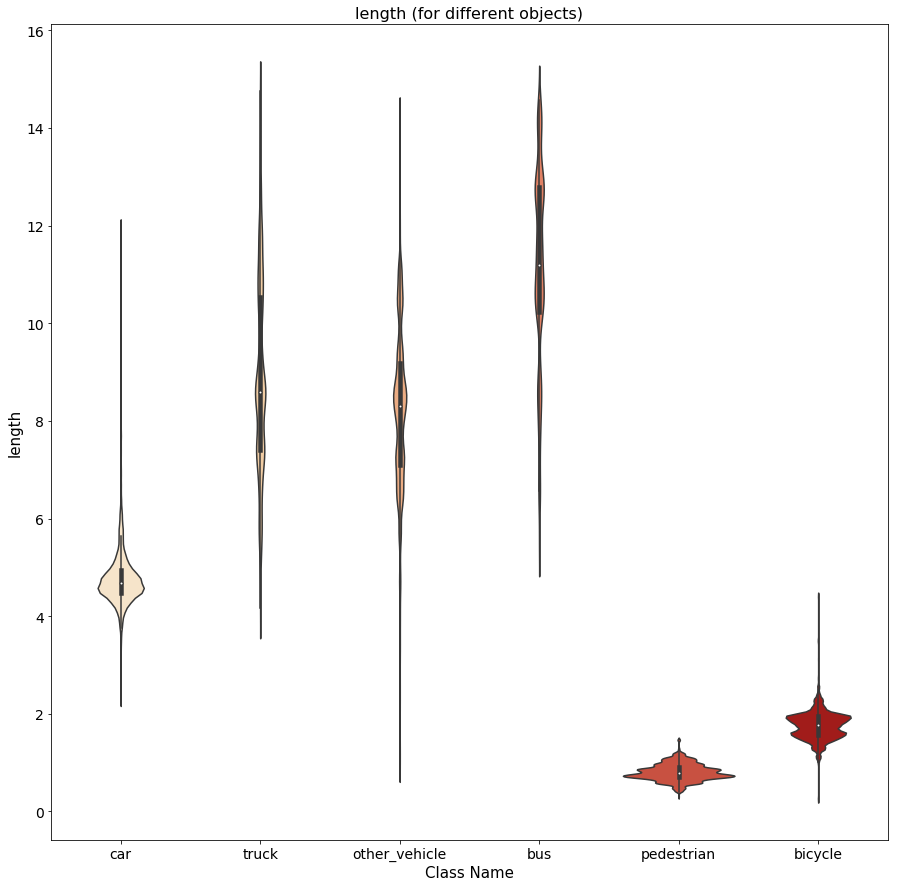

In [64]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.violinplot(x="class_name", y="length",
                      data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal" and length < 15'),
                      palette='OrRd',
                      split=True, ax=ax).set_title('length (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("length", fontsize=15)
plt.show(plot)

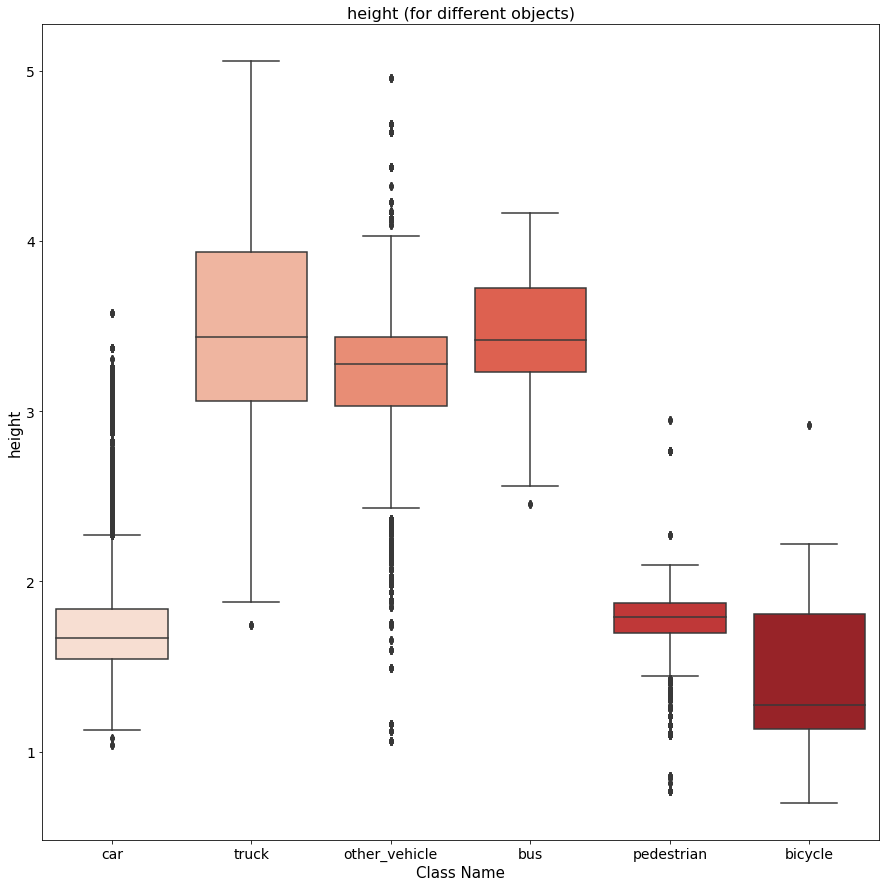

In [65]:
fig, ax = plt.subplots(figsize=(15, 15))

plot = sns.boxplot(x="class_name", y="height",
                   data=train_objects.query('class_name != "motorcycle" and class_name != "emergency_vehicle" and class_name != "animal" and height < 6'),
                   palette='Reds', ax=ax).set_title('height (for different objects)', fontsize=16)

plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.xlabel("Class Name", fontsize=15)
plt.ylabel("height", fontsize=15)
plt.show(plot)

## Animation of scenes

In [20]:
def generate_next_token(scene):
    scene = level5data.scene[scene]
    sample_token = scene['first_sample_token']
    sample_record = level5data.get("sample", sample_token)
    
    while sample_record['next']:
        sample_token = sample_record['next']
        sample_record = level5data.get("sample", sample_token)
        
        yield sample_token

def animate_images(scene, frames, pointsensor_channel='LIDAR_TOP', interval=1):
    cams = [
        'CAM_FRONT',
        'CAM_FRONT_RIGHT',
        'CAM_BACK_RIGHT',
        'CAM_BACK',
        'CAM_BACK_LEFT',
        'CAM_FRONT_LEFT',
    ]

    generator = generate_next_token(scene)

    fig, axs = plt.subplots(
        2, len(cams), figsize=(3*len(cams), 6), 
        sharex=True, sharey=True, gridspec_kw = {'wspace': 0, 'hspace': 0.1}
    )
    
    plt.close(fig)

    def animate_fn(i):
        for _ in range(interval):
            sample_token = next(generator)
            
        for c, camera_channel in enumerate(cams):    
            sample_record = level5data.get("sample", sample_token)

            pointsensor_token = sample_record["data"][pointsensor_channel]
            camera_token = sample_record["data"][camera_channel]
            
            axs[0, c].clear()
            axs[1, c].clear()
            
            level5data.render_sample_data(camera_token, with_anns=False, ax=axs[0, c])
            level5data.render_sample_data(camera_token, with_anns=True, ax=axs[1, c])
            
            axs[0, c].set_title("")
            axs[1, c].set_title("")

    anim = animation.FuncAnimation(fig, animate_fn, frames=frames, interval=interval)
    
    return anim

In [21]:
anim = animate_images(scene=3, frames=100, interval=1)
HTML(anim.to_jshtml(fps=8))

## YOLO NET MODEL
They functions below are used to create the YOLOv3 Neural Network in Keras, and are obtained from existing base such as 
on: https://machinelearningmastery.com/how-to-perform-object-detection-with-yolov3-in-keras/

In [22]:
# create a YOLOv3 Keras model and save it to file

import struct
import numpy as np
from keras.layers import Conv2D
from keras.layers import Input
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU
from keras.layers import ZeroPadding2D
from keras.layers import UpSampling2D
from keras.layers.merge import add, concatenate
from keras.models import Model
 
def _conv_block(inp, convs, skip=True):
    x = inp
    count = 0
    for conv in convs:
        if count == (len(convs) - 2) and skip:
            skip_connection = x
        count += 1
        if conv['stride'] > 1: x = ZeroPadding2D(((1,0),(1,0)))(x) # peculiar padding as darknet prefer left and top
        x = Conv2D(conv['filter'],
                   conv['kernel'],
                   strides=conv['stride'],
                   padding='valid' if conv['stride'] > 1 else 'same', # peculiar padding as darknet prefer left and top
                   name='conv_' + str(conv['layer_idx']),
                   use_bias=False if conv['bnorm'] else True)(x)
        if conv['bnorm']: x = BatchNormalization(epsilon=0.001, name='bnorm_' + str(conv['layer_idx']))(x)
        if conv['leaky']: x = LeakyReLU(alpha=0.1, name='leaky_' + str(conv['layer_idx']))(x)
    return add([skip_connection, x]) if skip else x

def make_yolov3_model():
    input_image = Input(shape=(None, None, 3))
    # Layer  0 => 4
    x = _conv_block(input_image, [{'filter': 32, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 0},
                                  {'filter': 64, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 1},
                                  {'filter': 32, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 2},
                                  {'filter': 64, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 3}])
    # Layer  5 => 8
    x = _conv_block(x, [{'filter': 128, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 5},
                        {'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 6},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 7}])
    # Layer  9 => 11
    x = _conv_block(x, [{'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 9},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 10}])
    # Layer 12 => 15
    x = _conv_block(x, [{'filter': 256, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 12},
                        {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 13},
                        {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 14}])
    # Layer 16 => 36
    for i in range(7):
        x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 16+i*3},
                            {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 17+i*3}])
    skip_36 = x
    # Layer 37 => 40
    x = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 37},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 38},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 39}])
    # Layer 41 => 61
    for i in range(7):
        x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 41+i*3},
                            {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 42+i*3}])
    skip_61 = x
    # Layer 62 => 65
    x = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 62},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 63},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 64}])
    # Layer 66 => 74
    for i in range(3):
        x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 66+i*3},
                            {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 67+i*3}])
    # Layer 75 => 79
    x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 75},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 76},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 77},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 78},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 79}], skip=False)
    # Layer 80 => 82
    yolo_82 = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 80},
                              {'filter':  255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 81}], skip=False)
    # Layer 83 => 86
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 84}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_61])
    # Layer 87 => 91
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 87},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 88},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 89},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 90},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 91}], skip=False)
    # Layer 92 => 94
    yolo_94 = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 92},
                              {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 93}], skip=False)
    # Layer 95 => 98
    x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,   'layer_idx': 96}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_36])
    # Layer 99 => 106
    yolo_106 = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 99},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 100},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 101},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 102},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 103},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 104},
                               {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 105}], skip=False)
    model = Model(input_image, [yolo_82, yolo_94, yolo_106])
    return model

class WeightReader:
    def __init__(self, weight_file):
        with open(weight_file, 'rb') as w_f:
            major,	= struct.unpack('i', w_f.read(4))
            minor,	= struct.unpack('i', w_f.read(4))
            revision, = struct.unpack('i', w_f.read(4))
            if (major*10 + minor) >= 2 and major < 1000 and minor < 1000:
                w_f.read(8)
            else:
                w_f.read(4)
            transpose = (major > 1000) or (minor > 1000)
            binary = w_f.read()
        self.offset = 0
        self.all_weights = np.frombuffer(binary, dtype='float32')
 
    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset-size:self.offset]

    def load_weights(self, model):
        for i in range(106):
            try:
                conv_layer = model.get_layer('conv_' + str(i))
                print("loading weights of convolution #" + str(i))
                if i not in [81, 93, 105]:
                    norm_layer = model.get_layer('bnorm_' + str(i))
                    size = np.prod(norm_layer.get_weights()[0].shape)
                    beta  = self.read_bytes(size) # bias
                    gamma = self.read_bytes(size) # scale
                    mean  = self.read_bytes(size) # mean
                    var   = self.read_bytes(size) # variance
                    weights = norm_layer.set_weights([gamma, beta, mean, var])
                if len(conv_layer.get_weights()) > 1:
                    bias   = self.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel, bias])
                else:
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel])
            except ValueError:
                print("no convolution #" + str(i))

    def reset(self):
        self.offset = 0


Using TensorFlow backend.


## Visualization Functions
The underlying class and functions are used to show the predictions of the detected objects in the original picture.

In [23]:
from matplotlib import pyplot
from matplotlib.patches import Rectangle
 
class BoundBox:
    def __init__(self, xmin, ymin, xmax, ymax, objness = None, classes = None):
        self.xmin = xmin
        self.ymin = ymin
        self.xmax = xmax
        self.ymax = ymax
        self.objness = objness
        self.classes = classes
        self.label = -1
        self.score = -1

    def get_label(self):
        if self.label == -1:
            self.label = np.argmax(self.classes)

        return self.label

    def get_score(self):
        if self.score == -1:
            self.score = self.classes[self.get_label()]
 
        return self.score
 
def _sigmoid(x):
    return 1. / (1. + np.exp(-x))
 
def decode_netout(netout, anchors, obj_thresh, net_h, net_w):
    grid_h, grid_w = netout.shape[:2]
    nb_box = 3
    netout = netout.reshape((grid_h, grid_w, nb_box, -1))
    nb_class = netout.shape[-1] - 5
    boxes = []
    netout[..., :2]  = _sigmoid(netout[..., :2])
    netout[..., 4:]  = _sigmoid(netout[..., 4:])
    netout[..., 5:]  = netout[..., 4][..., np.newaxis] * netout[..., 5:]
    netout[..., 5:] *= netout[..., 5:] > obj_thresh
 
    for i in range(grid_h*grid_w):
        row = i / grid_w
        col = i % grid_w
        for b in range(nb_box):
            # 4th element is objectness score
            objectness = netout[int(row)][int(col)][b][4]
            if(objectness.all() <= obj_thresh): continue
            # first 4 elements are x, y, w, and h
            x, y, w, h = netout[int(row)][int(col)][b][:4]
            x = (col + x) / grid_w # center position, unit: image width
            y = (row + y) / grid_h # center position, unit: image height
            w = anchors[2 * b + 0] * np.exp(w) / net_w # unit: image width
            h = anchors[2 * b + 1] * np.exp(h) / net_h # unit: image height
            # last elements are class probabilities
            classes = netout[int(row)][col][b][5:]
            box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, objectness, classes)
            boxes.append(box)
    return boxes
 
def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
    new_w, new_h = net_w, net_h
    for i in range(len(boxes)):
        x_offset, x_scale = (net_w - new_w)/2./net_w, float(new_w)/net_w
        y_offset, y_scale = (net_h - new_h)/2./net_h, float(new_h)/net_h
        boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
        boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
        boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
        boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)

def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b
    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2,x4) - x1
    else:
        if x2 < x3:
            return 0
        else:
            return min(x2,x4) - x3

def bbox_iou(box1, box2):
    intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
    intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
    intersect = intersect_w * intersect_h
    w1, h1 = box1.xmax-box1.xmin, box1.ymax-box1.ymin
    w2, h2 = box2.xmax-box2.xmin, box2.ymax-box2.ymin
    union = w1*h1 + w2*h2 - intersect
    return float(intersect) / union
 
def do_nms(boxes, nms_thresh):
    if len(boxes) > 0:
        nb_class = len(boxes[0].classes)
    else:
        return
    for c in range(nb_class):
        sorted_indices = np.argsort([-box.classes[c] for box in boxes])
        for i in range(len(sorted_indices)):
            index_i = sorted_indices[i]
            if boxes[index_i].classes[c] == 0: continue
            for j in range(i+1, len(sorted_indices)):
                index_j = sorted_indices[j]
                if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
                    boxes[index_j].classes[c] = 0

# load and prepare an image
def load_image_pixels(filename, shape):
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    # convert to numpy array
    image = img_to_array(image)
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height
 
# get all of the results above a threshold
def get_boxes(boxes, labels, thresh):
    v_boxes, v_labels, v_scores = list(), list(), list()
    # enumerate all boxes
    for box in boxes:
        # enumerate all possible labels
        for i in range(len(labels)):
            # check if the threshold for this label is high enough
            if box.classes[i] > thresh:
                v_boxes.append(box)
                v_labels.append(labels[i])
                v_scores.append(box.classes[i]*100)
                # don't break, many labels may trigger for one box
    return v_boxes, v_labels, v_scores
 
# draw all results
def draw_boxes(filename, v_boxes, v_labels, v_scores):
    # load the image
    data = pyplot.imread(filename)
    # plot the image
    pyplot.imshow(data)
    # get the context for drawing boxes
    ax = pyplot.gca()
    # plot each box
    for i in range(len(v_boxes)):
        box = v_boxes[i]
        # get coordinates
        y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
        # calculate width and height of the box
        width, height = x2 - x1, y2 - y1
        # create the shape
        rect = Rectangle((x1, y1), width, height, fill=False, color='white')
        # draw the box
        ax.add_patch(rect)
        # draw text and score in top left corner
        label = "%s (%.3f)" % (v_labels[i], v_scores[i])
        pyplot.text(x1, y1, label, color='white')
    # show the plot
    pyplot.show()

## Create the YOLO Model

In [24]:
# define the model
model = make_yolov3_model()

# load the model weights
weight_reader = WeightReader('../input/lyft-3d-recognition/yolov3.weights')

# set the model weights into the model
weight_reader.load_weights(model)

# save the model to file
model.save('model.h5')

loading weights of convolution #0
loading weights of convolution #1
loading weights of convolution #2
loading weights of convolution #3
no convolution #4
loading weights of convolution #5
loading weights of convolution #6
loading weights of convolution #7
no convolution #8
loading weights of convolution #9
loading weights of convolution #10
no convolution #11
loading weights of convolution #12
loading weights of convolution #13
loading weights of convolution #14
no convolution #15
loading weights of convolution #16
loading weights of convolution #17
no convolution #18
loading weights of convolution #19
loading weights of convolution #20
no convolution #21
loading weights of convolution #22
loading weights of convolution #23
no convolution #24
loading weights of convolution #25
loading weights of convolution #26
no convolution #27
loading weights of convolution #28
loading weights of convolution #29
no convolution #30
loading weights of convolution #31
loading weights of convolution #32

## Loading the YOLO Model
As the weights have now been saved in an h5 file (which can be found in the output files), we load it into the model.

In [25]:
# load yolov3 model
from keras.models import load_model
model = load_model('model.h5')

In [26]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 3 0                                            
__________________________________________________________________________________________________
conv_0 (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
bnorm_0 (BatchNormalization)    (None, None, None, 3 128         conv_0[0][0]                     
__________________________________________________________________________________________________
leaky_0 (LeakyReLU)             (None, None, None, 3 0           bnorm_0[0][0]                    
__________________________________________________________________________________________________
zero_paddi

## Test the Prediction of Objects in first 10 training images
To test the YOLO Model and if the implementation works, by predicting the objects in the first ten images of the training set.

In [27]:
# Parameters used in the Dataset, on which YOLOv3 was pretrained
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]

# define the expected input shape for the model
WIDTH, HEIGHT = 416, 416

# define the probability threshold for detected objects
class_threshold = 0.3

In [28]:
import os
from matplotlib import pyplot as plt
images = os.listdir('../input/3d-object-detection-for-autonomous-vehicles/train_images')[:10]

In [29]:
from numpy import expand_dims
from keras.preprocessing.image import load_img, img_to_array

# load and prepare an image
def load_image_pixels(filename, shape):
    '''
    Function preprocess the images to 416x416, which is the standard input shape for YOLOv3, 
    and also keeps track of the originl shape, which is later used to draw the boxes.
    
    paramters:
    filename {String}: path to the image
    shape {tuple}: shape of the input dimensions of the network
    
    returns:
    image {PIL}: image of shape 'shape'
    width {int}: original width of the picture
    height {int}: original height of the picture
    '''
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    
    # convert to numpy array
    image = img_to_array(image)
    
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height

Iterate through the pictures and detect the objects.

truck 94.47240233421326
car 71.33424878120422
car 57.38890767097473
car 95.99141478538513
car 96.51923775672913
bus 44.159525632858276
truck 70.85143327713013
car 37.07187473773956
car 35.22671163082123
truck 32.79102146625519
car 52.50139832496643
car 71.62013053894043
car 41.44318103790283
car 98.87382388114929


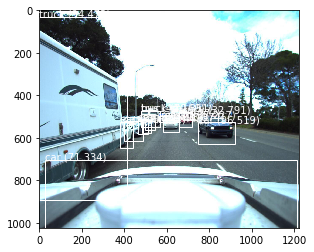

car 90.90200066566467
car 41.74528121948242
car 49.315935373306274
car 86.64723038673401


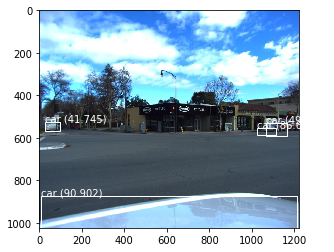

car 44.00638043880463
car 99.49303269386292
car 69.17536854743958
car 78.7386417388916
car 64.8408830165863
car 85.27180552482605
car 97.52064943313599
car 83.2088828086853
car 33.15470218658447


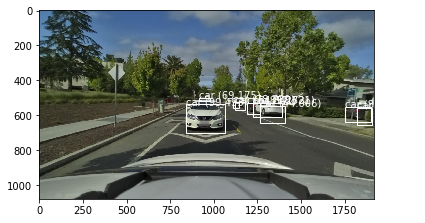

car 43.18581819534302
car 92.42860078811646
car 92.89239048957825


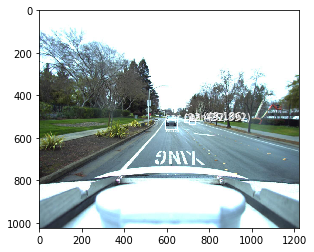

car 65.70577025413513
truck 54.95043396949768
car 40.10573327541351
truck 90.99632501602173
car 36.974069476127625
car 54.107075929641724
car 98.18232655525208
car 78.2330334186554
car 62.80314922332764
car 62.72594928741455


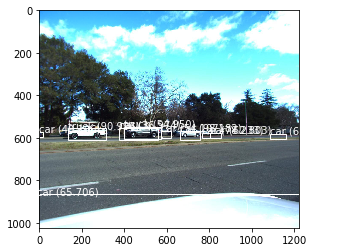

bus 92.19626784324646
car 88.94755244255066
car 87.45279908180237
truck 35.09664535522461
truck 39.33030664920807
car 31.529730558395386
car 80.00765442848206
car 38.52341175079346
car 31.965255737304688
car 41.98690056800842
car 99.15739893913269


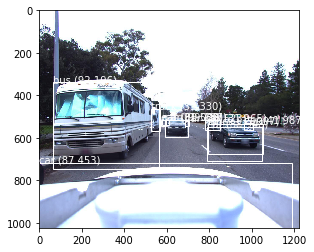

car 99.4914710521698
car 39.73972201347351
car 32.706499099731445
car 96.72788977622986
car 59.8081111907959
car 32.48153328895569
car 73.06863069534302
car 84.5885694026947
car 84.10609364509583
car 84.15658473968506
car 51.734769344329834


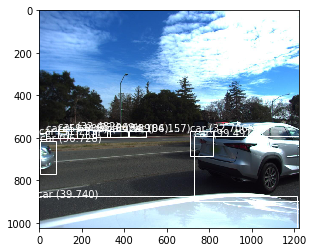

car 99.98246431350708
car 95.04622220993042
truck 56.46554231643677
car 84.31439995765686
car 39.08815681934357
car 31.059062480926514
car 44.72985863685608
car 91.98101162910461
car 62.90650963783264
car 69.01302933692932
car 94.28300261497498
car 39.20080363750458
car 89.67056274414062
car 50.714272260665894


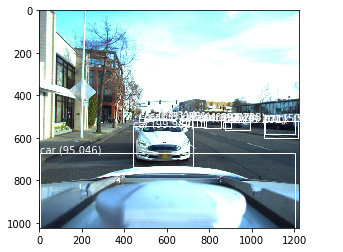

car 86.70346140861511
car 91.92036390304565
car 68.00507307052612
car 83.37287306785583
car 49.55475330352783
car 32.760241627693176
car 88.03302049636841
car 87.4018907546997
car 92.23202466964722
car 70.95179557800293
car 66.62480235099792


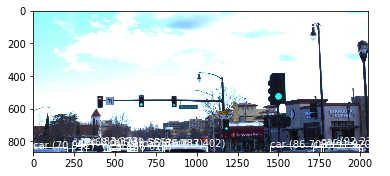

car 47.68282175064087
car 99.59219098091125
car 99.41357374191284
car 35.1456880569458
car 69.22145485877991
car 76.32824182510376
car 40.37817418575287
car 97.95092344284058


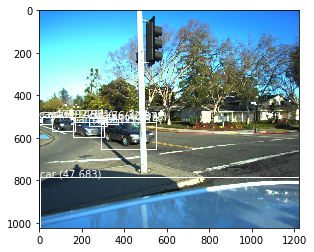

In [30]:
for file in images:
    photo_filename = DATA_PATH + 'train_images/' + file
    
    # load picture with old dimensions
    image, image_w, image_h = load_image_pixels(photo_filename, (WIDTH, HEIGHT))
    
    # Predict image
    yhat = model.predict(image)
    
    # Create boxes
    boxes = list()
    for i in range(len(yhat)):
        # decode the output of the network
        boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, HEIGHT, WIDTH)

    # correct the sizes of the bounding boxes for the shape of the image
    correct_yolo_boxes(boxes, image_h, image_w, HEIGHT, WIDTH)

    # suppress non-maximal boxes
    do_nms(boxes, 0.5)

    # define the labels (Filtered only the ones relevant for this task, which were used in pretraining the YOLOv3 model)
    labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck","boat"]

    # get the details of the detected objects
    v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)

    # summarize what we found
    for i in range(len(v_boxes)):

        print(v_labels[i], v_scores[i])

    # draw what we found
    draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

The YOLO model is able to successfully able to achieve object detection of the categories in the test data despite the visibility of the objects.